In [17]:
import json
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import matplotlib.image as mpimg


In [2]:
with open('../Data/goals.json') as f:
    goals = json.load(f)


In [233]:
goals_matrices = {}
for team, goal in goals.items():
    goals_matrices[team] = []
    for g in goal:
        temp_dict = {}
        region_list = []
        player_list = []
        
        region_list.append(g['region'])
        player_list.append(g['playerIndex'])
        
        for p in g['passes']:
            region_list.append(p['region'])
            player_list.append(p['playerIndex'])
            
        edge_list_regions = []
        goal_matrix_regions = np.zeros((18,18))
        
        edge_list_players = []
        goal_matrix_players = np.zeros((11,11))
        
        for i in range(len(region_list)-1):
            edge_list_regions.append([region_list[i+1], region_list[i]])
            goal_matrix_regions[region_list[i+1]-1][region_list[i]-1] += 1

            if player_list[i+1] == player_list[i]:
                continue
            else:
                edge_list_players.append([player_list[i+1], player_list[i]])
                goal_matrix_players[player_list[i+1]-1][player_list[i]-1] += 1
            
        temp_dict['opponentId'] = g['opponentId']
        temp_dict['matchId'] = g['matchId']
        temp_dict['regionEdgeList'] = edge_list_regions
        temp_dict['playerEdgeList'] = edge_list_players
        temp_dict['regionMatrix'] = goal_matrix_regions
        temp_dict['playerMatrix'] = goal_matrix_players
        goals_matrices[team].append(temp_dict)



In [235]:
total_goals_matrices = {}
for team, goal in goals_matrices.items():
    total_region_matrix = np.zeros((18,18))
    total_player_matrix = np.zeros((11,11))
    
    temp_dict = {}
    for g in goal:
        total_region_matrix += g['regionMatrix']
        total_player_matrix += g['playerMatrix']
        
    temp_dict['total_region_matrix'] = total_region_matrix
    temp_dict['total_player_matrix'] = total_player_matrix
    total_goals_matrices[team] = temp_dict


In [236]:
for t, m in total_goals_matrices.items():
    for i in range(len(m['total_player_matrix'])):
        for j in range(len(m['total_player_matrix'][i])):
            if i == j:
                if m['total_player_matrix'][i][j] != 0:
                    print(t)
                    print(m['total_player_matrix'][i][j])
    # print(m['total_player_matrix'])

In [240]:
class NumpyEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.ndarray):
            return obj.tolist()
        return json.JSONEncoder.default(self, obj)

In [241]:
with open('../Data/goals_matrices.json', 'w') as f:
    json.dump(total_goals_matrices, f, cls=NumpyEncoder)


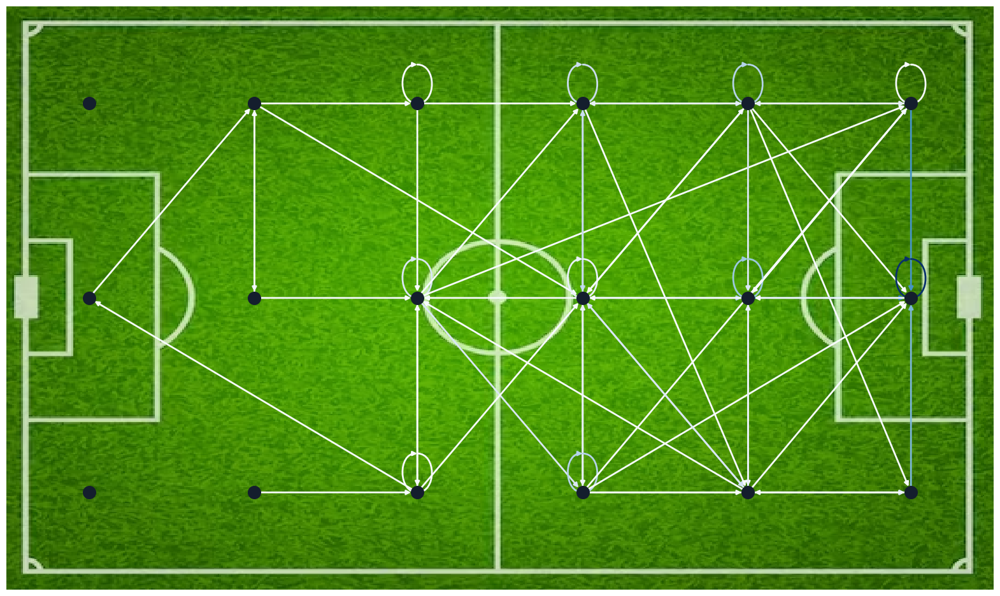

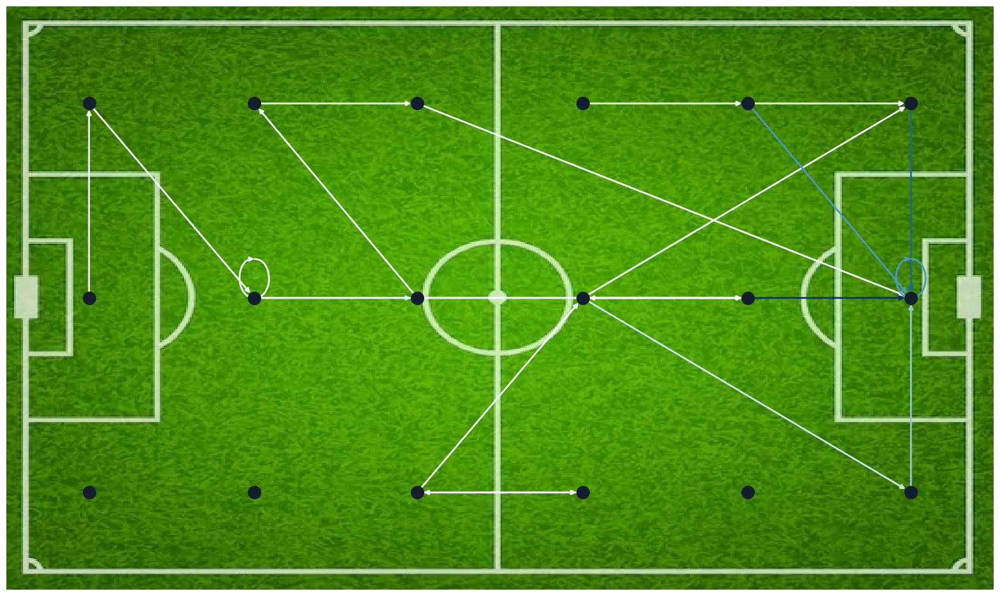

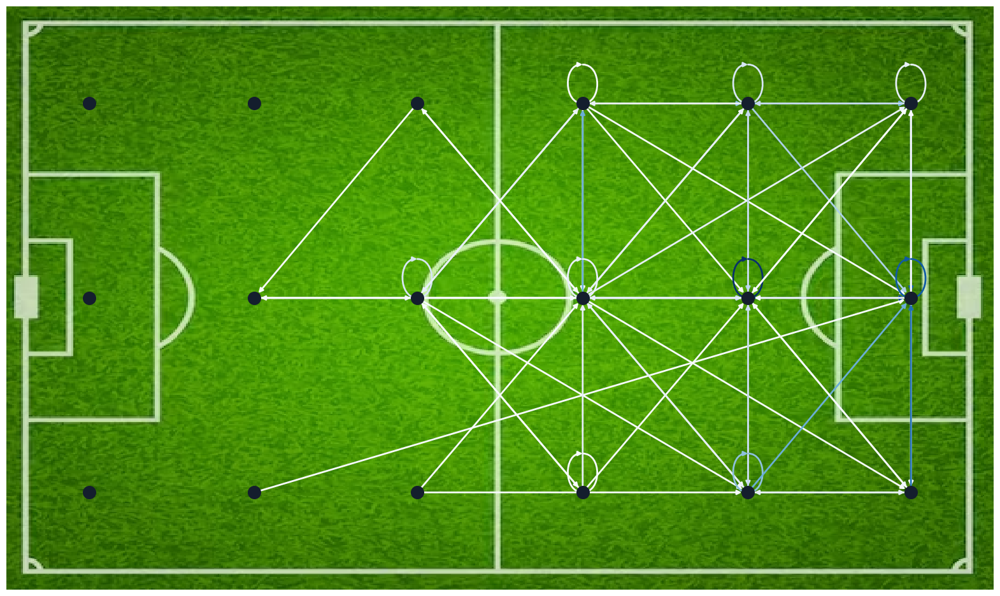

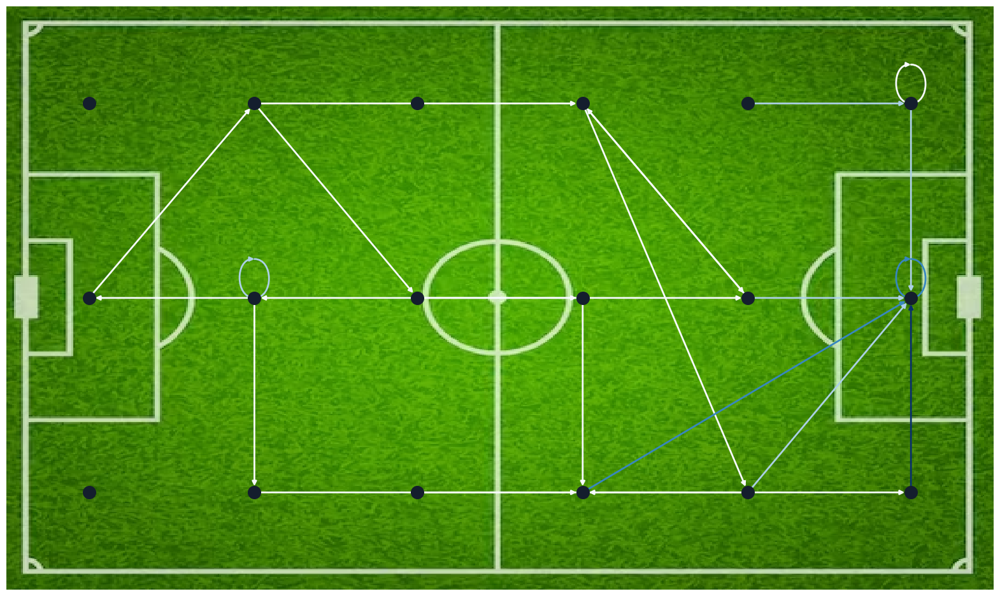

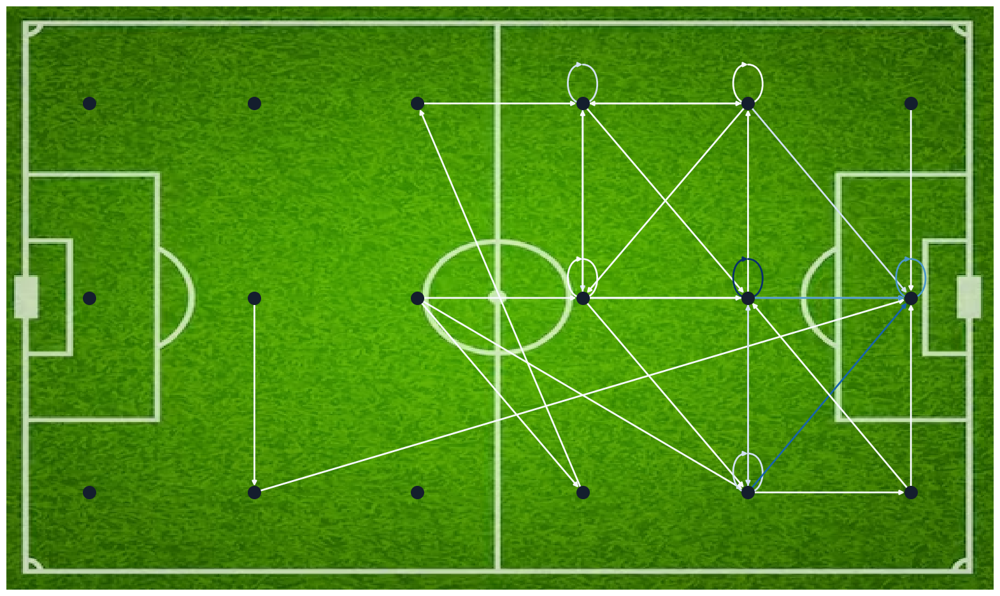

...

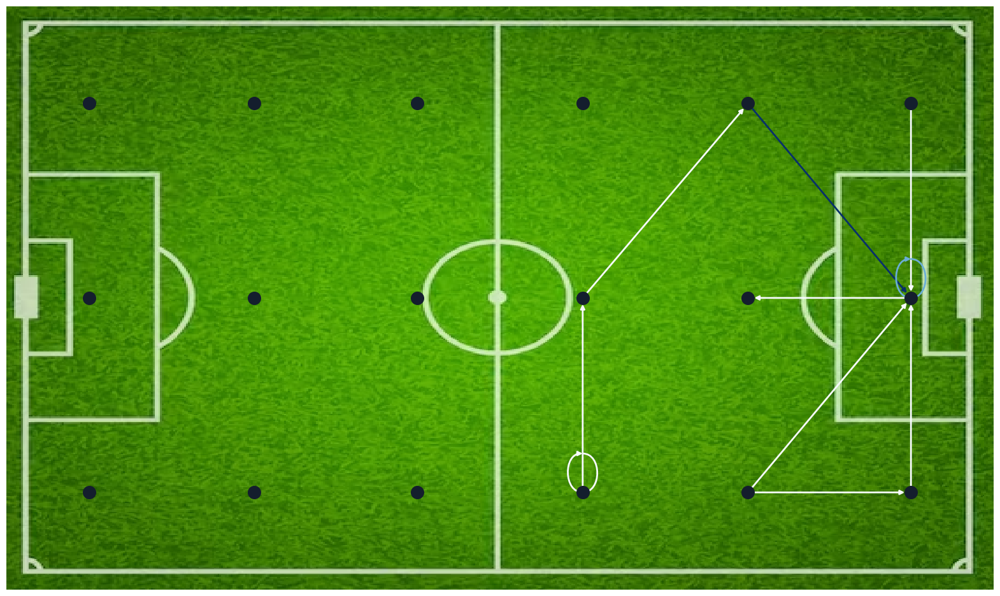

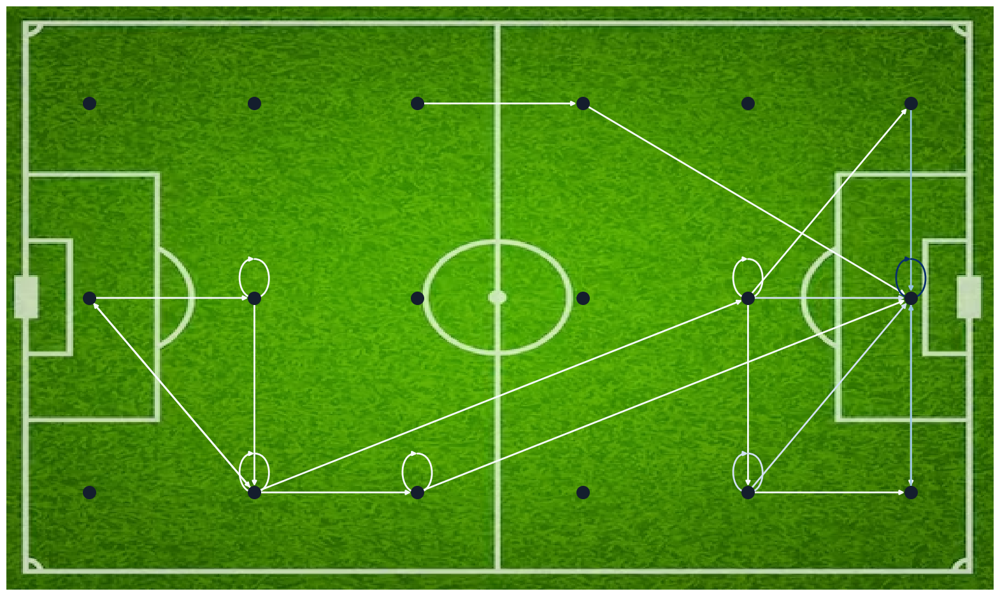

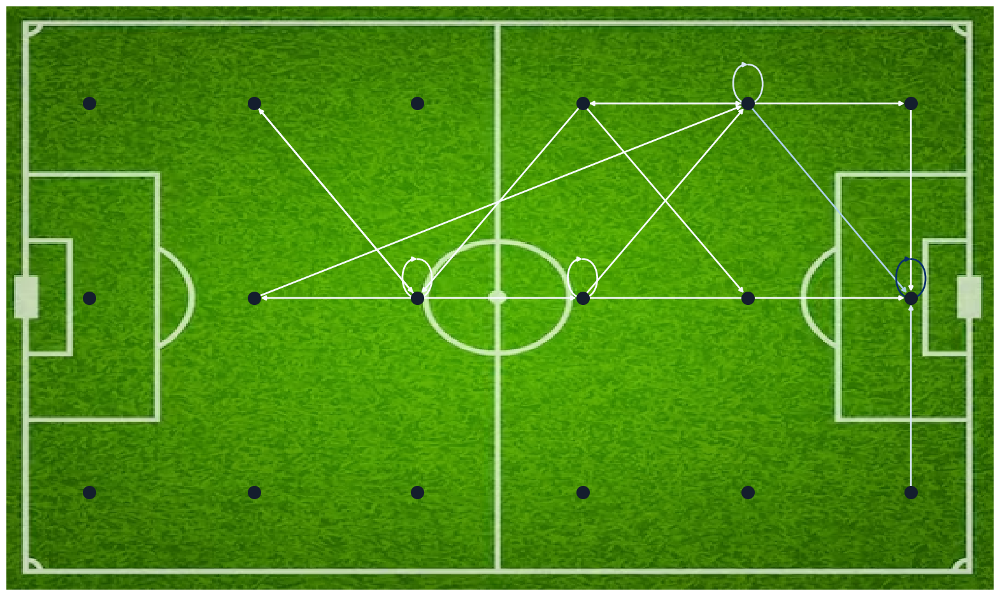

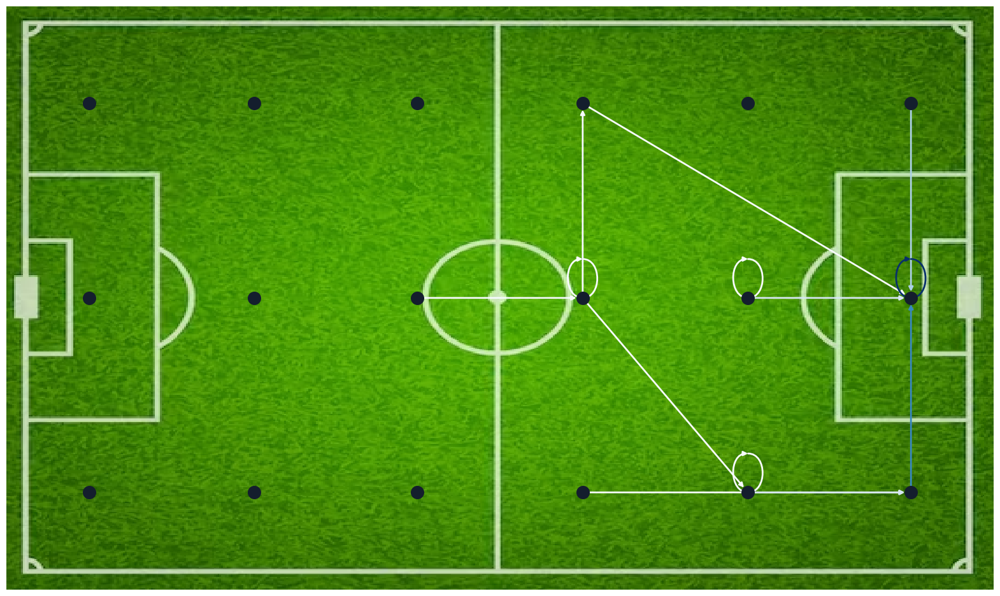

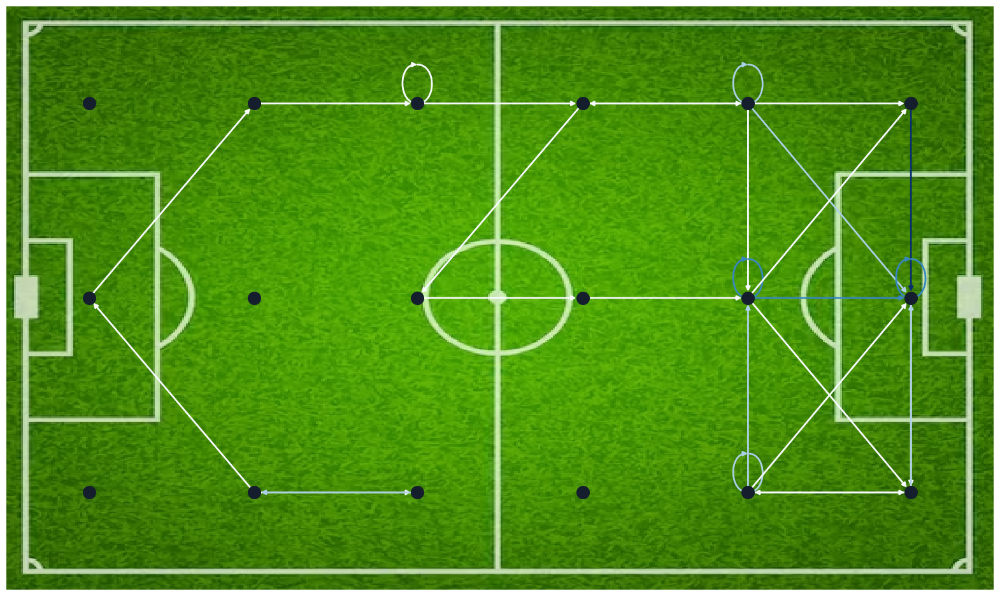

In [223]:
img = mpimg.imread('../images/pitch3.png')

x = [34, 34, 34, 102, 102, 102, 169, 169, 169, 237, 237, 237, 305, 305, 305, 372, 372, 372]
y = [200, 120, 40, 200, 120, 40, 200, 120, 40, 200, 120, 40, 200, 120, 40, 200, 120, 40]
coords = {}
for i in range(18):
    coords[i] = zip([x[i], y[i]])

for teamId in total_goals_matrices.keys():
    adjMat = total_goals_matrices[teamId]['total_region_matrix']
    
    G = nx.from_numpy_array(np.matrix(adjMat), create_using=nx.DiGraph)
    coords = list(zip(x,y))
    
    fig = plt.figure(frameon=False, figsize=(20,40))
    
    plt.imshow(img, extent=extent, interpolation='nearest')
    pos = {}
    for i in range(18):
        pos[i] = coords[i]
    edgewidth = [ d['weight'] for (u,v,d) in G.edges(data=True)]
    
    nx.draw(G,
            pos=pos,
            node_size=200,
            edge_color=edgewidth,
            width=2,
            edge_cmap=plt.cm.Blues,
            node_color='#141E2D'
            )
    plt.savefig(f'../images/teamsRegionsGraphs/{teamId}.png')
    # plt.show()
        


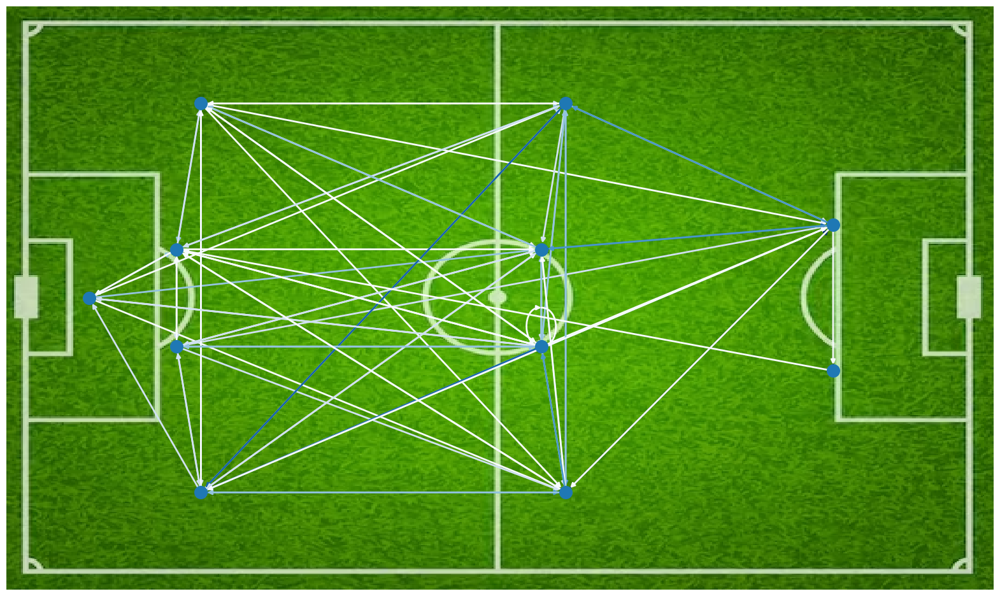

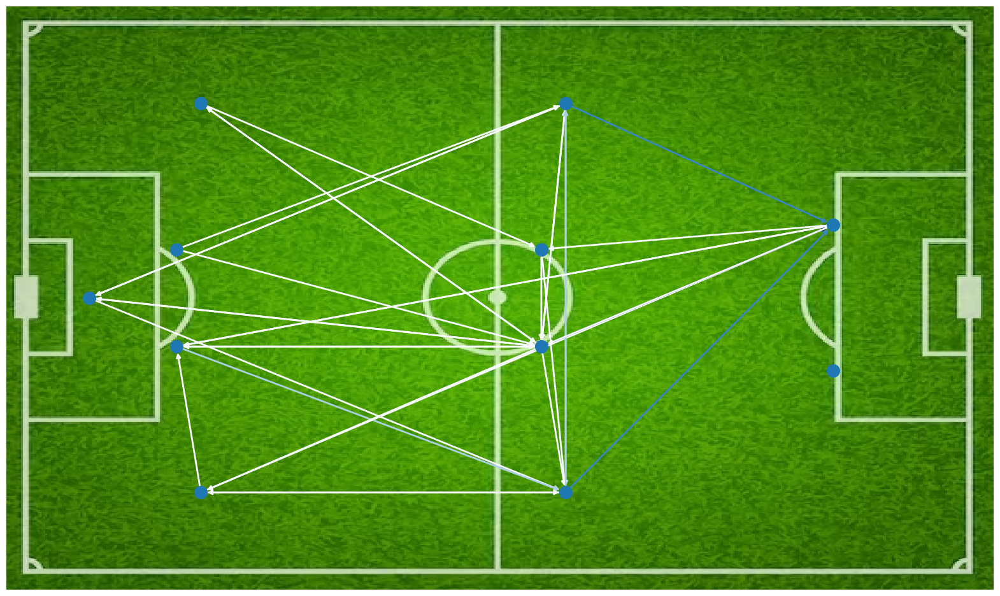

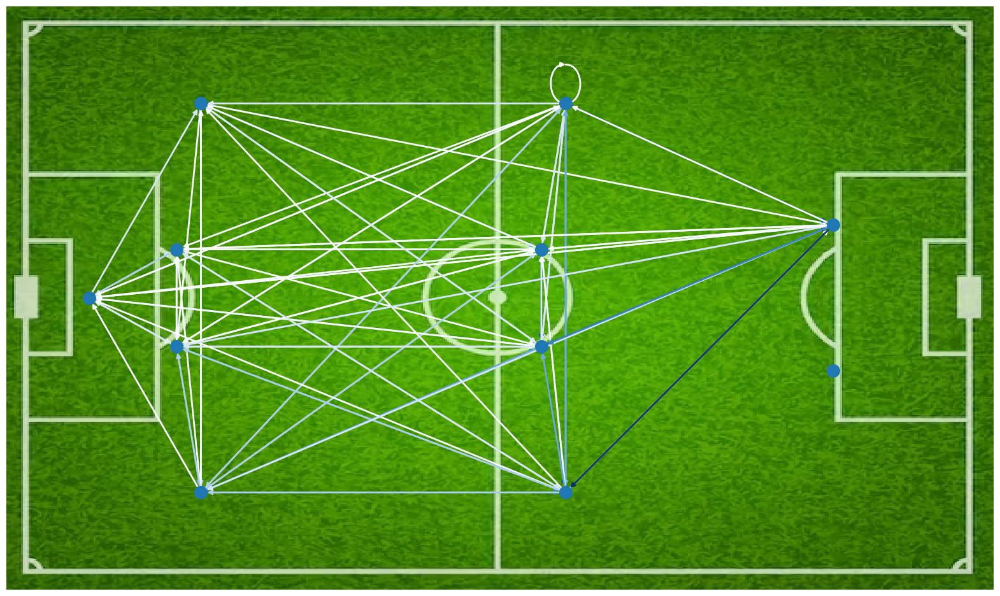

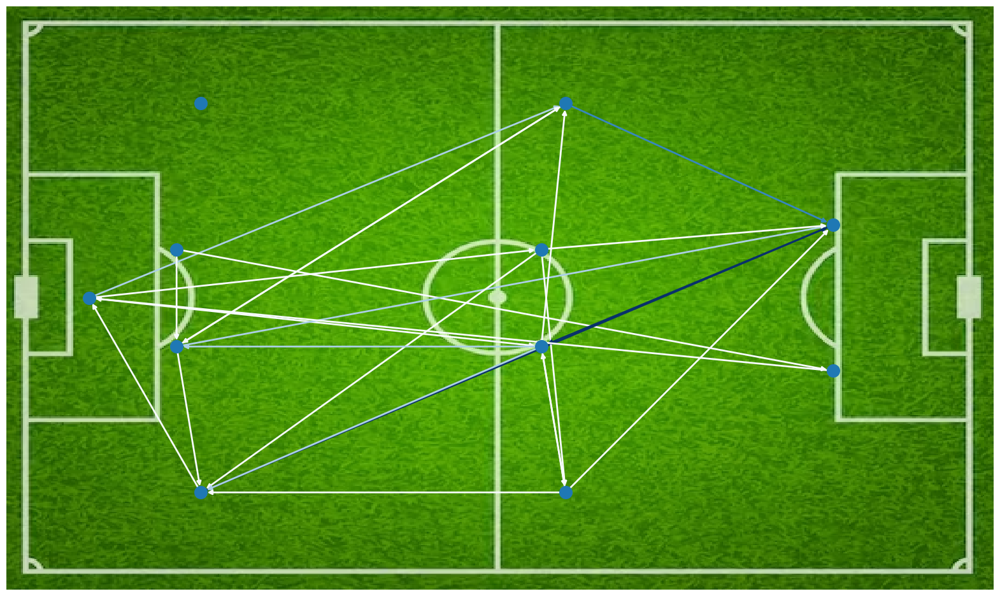

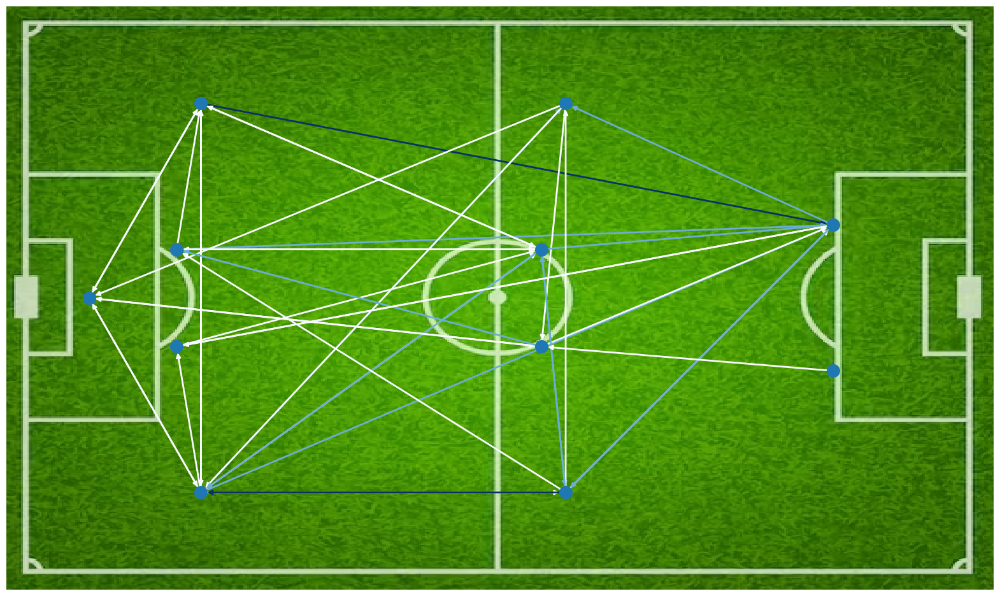

...

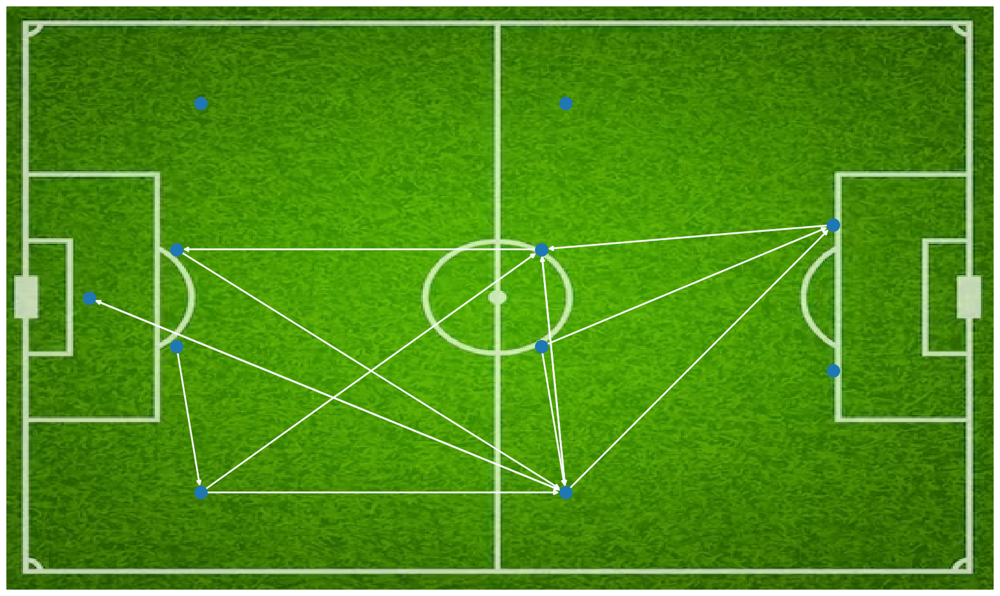

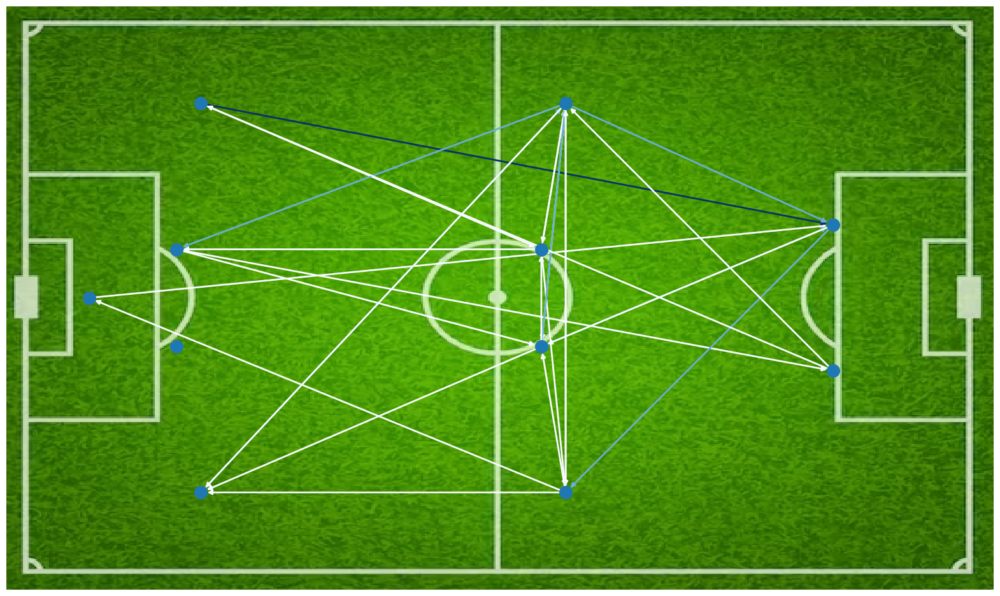

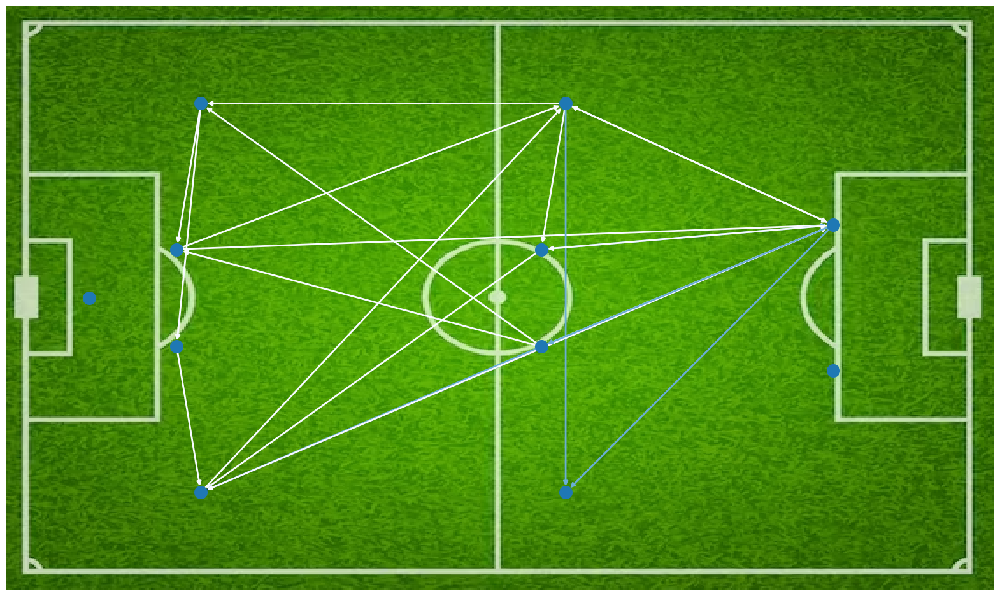

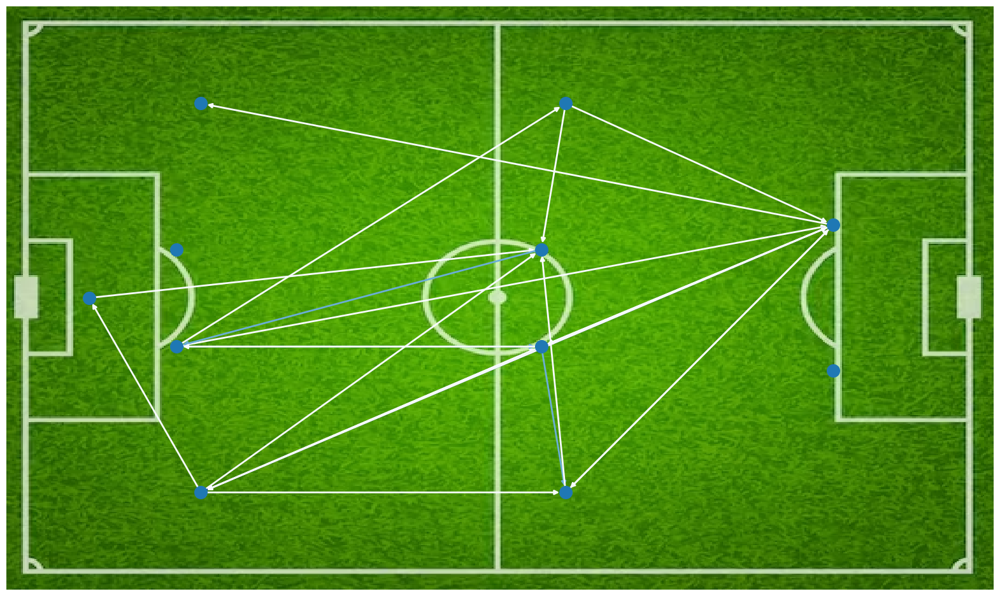

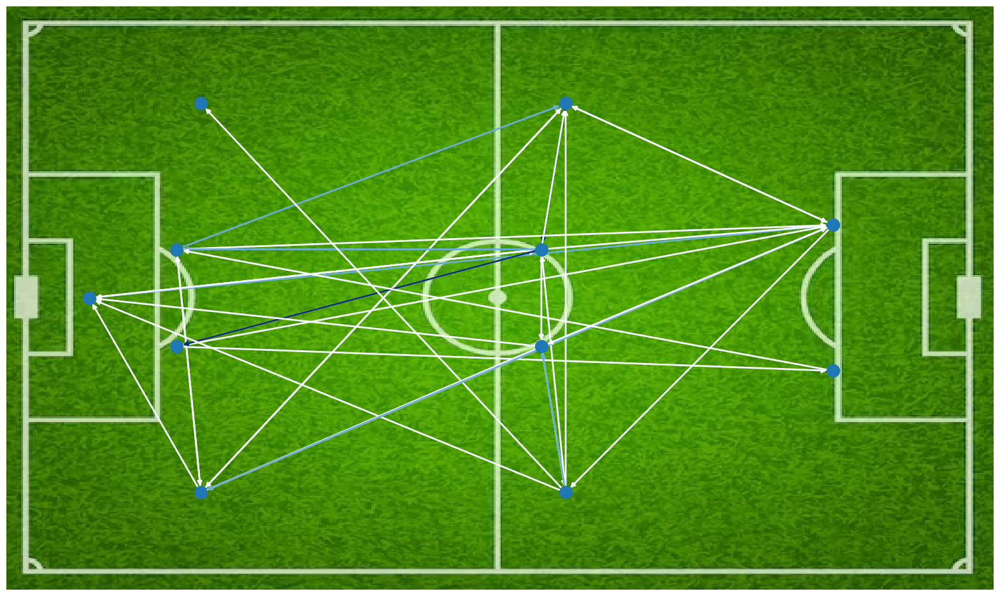

In [226]:
x = [34, 80, 70, 70, 80, 230, 220, 220, 230, 340, 340]
y = [120, 200, 140, 100, 40, 200, 140, 100, 40, 150, 90]

coords = {}
for i in range(11):
    coords[i] = zip([x[i], y[i]])

for teamId in total_goals_matrices.keys():
    adjMat = total_goals_matrices[teamId]['total_player_matrix']

    G = nx.from_numpy_array(np.matrix(adjMat), create_using=nx.DiGraph)
    coords = list(zip(x,y))
    
    fig = plt.figure(frameon=False, figsize=(20,40))
    
    plt.imshow(img, extent=extent, interpolation='nearest')
        
    pos = {}
    for i in range(11):
            pos[i] = coords[i]
    
    edgewidth = [ d['weight'] for (u,v,d) in G.edges(data=True)]
    
    nx.draw(G,
            pos=pos,
            node_size=200,
            edge_color=edgewidth,
            edge_cmap=plt.cm.Blues,
            width=2)
    plt.savefig(f'../images/teamsPlayersGraphs/{teamId}.png')
    # plt.show()


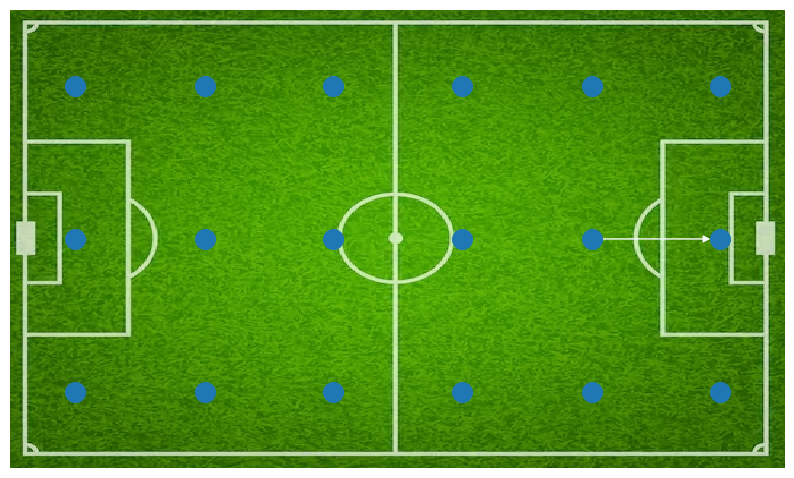

In [189]:

adjMat = goals_matrices['1609'][2]['regionMatrix']
img = mpimg.imread('../images/pitch3.png')

x = [34, 34, 34, 102, 102, 102, 169, 169, 169, 237, 237, 237, 305, 305, 305, 372, 372, 372]
y = [200, 120, 40, 200, 120, 40, 200, 120, 40, 200, 120, 40, 200, 120, 40, 200, 120, 40]

coords = {}
for i in range(18):
    coords[i] = zip([x[i], y[i]])

G = nx.from_numpy_array(np.matrix(adjMat), create_using=nx.DiGraph)
coords = list(zip(x,y))

fig = plt.figure(frameon=False, figsize=(10,19))

plt.imshow(img, extent=extent, interpolation='nearest')
pos = {}
for i in range(18):
    pos[i] = coords[i]
edgewidth = [ d['weight'] for (u,v,d) in G.edges(data=True)]

nx.draw(G,
        pos=pos,
        node_size=200,
        edge_color=edgewidth,
        edge_cmap=plt.cm.Blues,
        )

plt.show()

    


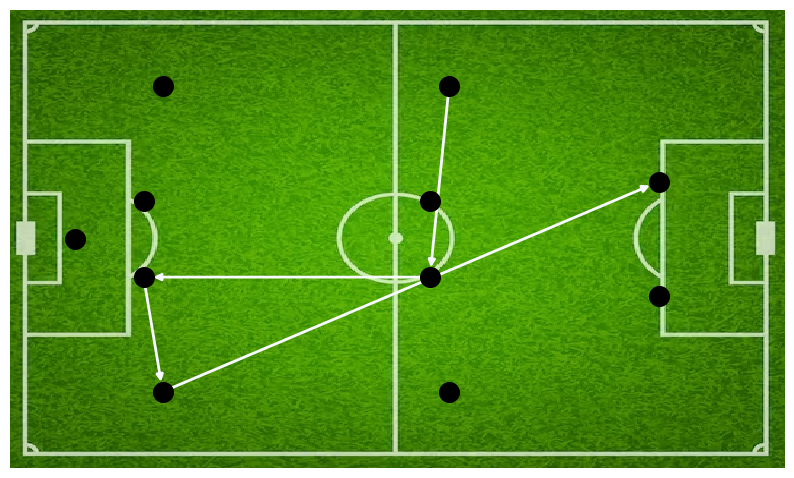

In [231]:
x = [34, 80, 70, 70, 80, 230, 220, 220, 230, 340, 340]
y = [120, 200, 140, 100, 40, 200, 140, 100, 40, 150, 90]

coords = {}
for i in range(11):
    coords[i] = zip([x[i], y[i]])
    
adjMat = goals_matrices['1609'][0]['playerMatrix']

G = nx.from_numpy_array(np.matrix(adjMat), create_using=nx.DiGraph)
coords = list(zip(x,y))

fig = plt.figure(frameon=False, figsize=(10,19))

plt.imshow(img, extent=extent, interpolation='nearest')
pos = {}
for i in range(11):
    pos[i] = coords[i]
edgewidth = [ d['weight'] for (u,v,d) in G.edges(data=True)]

nx.draw(G,
        pos=pos,
        node_size=200,
        edge_color=edgewidth,
        node_color='black',
        edge_cmap=plt.cm.Blues,
        width=2)

plt.show()


In [232]:
print('\n'.join([''.join(['{:4}'.format(item) for item in row]) 
      for row in adjMat]))

 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0
 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0
 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0
 0.0 0.0 0.0 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0
 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 1.0 0.0
 0.0 0.0 0.0 0.0 0.0 0.0 0.0 1.0 0.0 0.0 0.0
 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0
 0.0 0.0 0.0 1.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0
 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0
 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0
 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0
